# Unit 5 - Financial Planning


In [1]:

# Initial imports
import os
import requests
import json
import pandas as pd
from dotenv import load_dotenv
import alpaca_trade_api as tradeapi
from MCForecastTools import MCSimulation

%matplotlib inline

In [2]:
# Load .env enviroment variables
load_dotenv()


True

## Part 1 - Personal Finance Planner

### Collect Crypto Prices Using the `requests` Library

In [3]:
# Set current amount of crypto assets
btc_qty = 1.2
eth_qty = 5.3

In [4]:
# Crypto API URLs
btc_url = "https://api.alternative.me/v2/ticker/Bitcoin/?convert=CAD"
eth_url = "https://api.alternative.me/v2/ticker/Ethereum/?convert=CAD"

In [5]:
# BTC
## Fetch current price
response_data = requests.get(btc_url).json()
#print(json.dumps(response_data, indent=4))
btc_price = response_data['data']['1']['quotes']['USD']['price']

# Compute current value of my crpto
btc_value = round((btc_qty * btc_price),2)

In [6]:
# ETH
## Fetch current price
response_data = requests.get(eth_url).json()
eth_price = response_data['data']['1027']['quotes']['USD']['price']

# Compute current value of my crpto
eth_value = round((eth_qty * eth_price),2)

In [8]:
# %%
# Print current crypto wallet balance
print(f"The current value of your {btc_price} BTC is ${btc_value:0.2f}")
print(f"The current value of your {eth_price} ETH is ${eth_value:0.2f}")

The current value of your 11381.67 BTC is $13658.00
The current value of your 375.84 ETH is $1991.95


### Collect Investments Data Using Alpaca: `SPY` (stocks) and `AGG` (bonds)

In [9]:
# Current amount of stocks and bonds 
spy_qty = 50
agg_qty = 200 

In [10]:
# Set Alpaca API key and secret
alpaca_api_key = os.getenv("GGC_ALPACA_API_KEY")
alpaca_secret_key = os.getenv("GGC_ALPACA_SECRET_KEY")

# Create the Alpaca API object
alpaca = tradeapi.REST(
    alpaca_api_key,
    alpaca_secret_key,
    api_version="v2"
)

In [11]:
# Format current date as ISO format
start_date = pd.Timestamp("2020-10-09", tz="America/New_York").isoformat()
#start_date = pd.Timestamp.today(tz="America/New_York").isoformat()[0:10]    #[0:10] only date

end_date = pd.Timestamp("2020-10-09", tz="America/New_York").isoformat()
#end_date = pd.Timestamp.today(tz="America/New_York").isoformat()[0:10]      #[0:10] only date

# Set the tickers
tickers = ["AGG", "SPY"]

# Set timeframe to '1D' 
timeframe = "1D"

# Get current closing prices for SPY and AGG
df_tickers = alpaca.get_barset(
    tickers,
    timeframe,
    start=start_date,
    end=end_date
).df

# Preview DataFrame
df_tickers.head()

AGG                                      SPY  \
                             open    high    low    close   volume    open   
time                                                                         
2020-10-09 00:00:00-04:00  117.65  117.74  117.5  117.705  2750029  345.56   

                                                             
                             high     low   close    volume  
time                                                         
2020-10-09 00:00:00-04:00  347.35  344.89  346.84  45969566

In [13]:

# Pick AGG and SPY close prices
agg_close_price = df_tickers['AGG']['close'][0]
spy_close_price = df_tickers['SPY']['close'][0]

# Print AGG and SPY close prices
print(f"Current AGG closing price: ${agg_close_price}")
print(f"Current SPY closing price: ${spy_close_price}")


Current AGG closing price: $117.705
Current SPY closing price: $346.84


In [14]:

# Compute the current value of shares
spy_value = round((spy_qty * spy_close_price),2)
agg_value = round((agg_qty * agg_close_price),2)

# Print current value of share
print(f"The current value of your {spy_qty} SPY shares is ${spy_value:0.2f}")
print(f"The current value of your {agg_qty} AGG shares is ${agg_value:0.2f}")

The current value of your 50 SPY shares is $17342.00
The current value of your 200 AGG shares is $23541.00


### Savings Health Analysis

In [15]:
# Set monthly household income
monthly_income = 12000 

# Create savings DataFrame
savings = {'amount': [(btc_value + eth_value), (spy_value + agg_value)]}
df_savings = pd.DataFrame(savings, columns = ['amount'], index=['crypto','shares'])

# Display savings DataFrame
display(df_savings)

,amount
crypto,15649.95
shares,40883.00


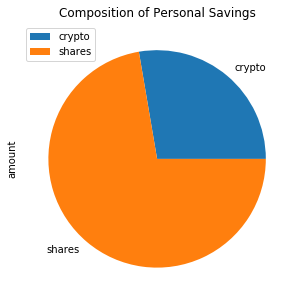

In [16]:
# Plot savings pie chart
df_savings.plot.pie(y='amount', figsize=(5,5), title='Composition of Personal Savings')

In [17]:
# Set ideal emergency fund
emergency_fund = monthly_income * 3

# Calculate total amount of savings
total_savings = float(df_savings.sum())

# Validate saving health
saving_healt = [
    f'Congratulations! Your savings ${total_savings} are greater than your emergency fund ${emergency_fund}',
    f'Congratulations! for reaching your goal. Savings ${total_savings} = emergency fund ${emergency_fund}',
    f'Your are ${emergency_fund - total_savings} away from reaching the goal'
    ]

if total_savings > emergency_fund: display (saving_healt[0])
elif total_savings == emergency_fund: display (saving_healt[1])
else: display (saving_healt[2])

'Congratulations! Your savings $56532.95 are greater than your emergency fund $36000'

## Part 2 - Retirement Planning

### Monte Carlo Simulation

In [18]:
# Set start and end dates of five years back from today.
# Sample results may vary from the solution based on the time frame chosen
start_date = pd.Timestamp('2015-08-07', tz='America/New_York').isoformat()
end_date = pd.Timestamp('2020-08-07', tz='America/New_York').isoformat()

In [19]:

# Get 5 years' worth of historical data for SPY and AGG

# Set the tickers
tickers = ["AGG", "SPY"]

# Set timeframe to '1D' 
timeframe = "1D"

# Get current closing prices for SPY and AGG
df_tickers = alpaca.get_barset(
    tickers,
    timeframe,
    start=start_date,
    end=end_date
).df

# Preview DataFrame
df_tickers.head()

AGG                                        \
                             open      high      low   close     volume   
time                                                                      
2015-08-07 00:00:00-04:00  109.14  109.2750  109.035  109.21  2041167.0   
2015-08-10 00:00:00-04:00  109.15  109.1700  108.920  109.06  1149778.0   
2015-08-11 00:00:00-04:00  109.42  109.5765  109.284  109.42  1420907.0   
2015-08-12 00:00:00-04:00  109.55  109.7100  109.350  109.36  1468979.0   
2015-08-13 00:00:00-04:00  109.36  109.3651  109.110  109.15  1465173.0   

                              SPY                                     
                             open    high     low   close     volume  
time                                                                  
2015-08-07 00:00:00-04:00  208.16  208.34  206.87  207.93   87669782  
2015-08-10 00:00:00-04:00  209.28  210.67  209.28  210.58   66755890  
2015-08-11 00:00:00-04:00  208.98  209.47  207.76  208.63   88424557  
2015-08-12 00:00:00-04:00  207.11  209.14  205.36  208.89  136171450  
2015-08-13 00:00:00-04:00  208.73  209.55  208.01  208.63   77197796

In [26]:
# Configuring a Monte Carlo simulation to forecast 30 years cumulative returns
# Set number of simulations
num_sims = 500
num_years = 30

# Configure a Monte Carlo simulation to forecast 30 year daily returns
MC_simulation = MCSimulation(
    portfolio_data = df_tickers,
    weights = [.4,.6],
    num_simulation = num_sims,
    num_trading_days = 252*num_years
)

In [27]:
# Print the simulation input data
MC_simulation.portfolio_data.head()

AGG                                        \
                             open      high      low   close     volume   
time                                                                      
2015-08-07 00:00:00-04:00  109.14  109.2750  109.035  109.21  2041167.0   
2015-08-10 00:00:00-04:00  109.15  109.1700  108.920  109.06  1149778.0   
2015-08-11 00:00:00-04:00  109.42  109.5765  109.284  109.42  1420907.0   
2015-08-12 00:00:00-04:00  109.55  109.7100  109.350  109.36  1468979.0   
2015-08-13 00:00:00-04:00  109.36  109.3651  109.110  109.15  1465173.0   

                                           SPY                          \
                          daily_return    open    high     low   close   
time                                                                     
2015-08-07 00:00:00-04:00          NaN  208.16  208.34  206.87  207.93   
2015-08-10 00:00:00-04:00    -0.001374  209.28  210.67  209.28  210.58   
2015-08-11 00:00:00-04:00     0.003301  208.98  209.47  207.76  208.63   
2015-08-12 00:00:00-04:00    -0.000548  207.11  209.14  205.36  208.89   
2015-08-13 00:00:00-04:00    -0.001920  208.73  209.55  208.01  208.63   

                                                   
                              volume daily_return  
time                                               
2015-08-07 00:00:00-04:00   87669782          NaN  
2015-08-10 00:00:00-04:00   66755890     0.012745  
2015-08-11 00:00:00-04:00   88424557    -0.009260  
2015-08-12 00:00:00-04:00  136171450     0.001246  
2015-08-13 00:00:00-04:00   77197796    -0.001245

In [28]:
# Run Monte Carlo simulations to forecast 30 years cumulative daily returns
# sanity check 
#      num.of rows = 30y * 252d = 7560 (0.. 7560)
#      num of columns = 500 number of simulations (0..499)

MC_simulation.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,1.016872,1.006125,1.004040,1.000518,1.003748,0.993868,0.998956,1.006075,1.001907,1.007731,...,0.997371,0.998798,0.993056,0.998285,0.991062,0.995705,1.002293,0.991488,1.011349,1.010145
2,1.005861,1.022027,1.018712,0.997924,1.004804,0.986726,1.013769,1.003706,0.998607,1.008283,...,0.999628,1.007437,1.015560,0.999681,1.005485,0.991646,0.992730,0.987073,1.017554,1.007776
3,0.994982,1.025610,1.022433,0.994618,1.007251,0.983191,1.016212,1.003057,1.010605,0.997990,...,0.991749,1.008242,1.022155,1.006896,1.004479,1.007779,0.995921,0.994657,1.027929,1.018950
4,0.992885,1.010307,1.026735,0.989101,1.025266,0.975986,1.012332,0.990375,1.007994,1.000750,...,0.984954,1.003419,1.033616,1.009719,1.011538,1.004691,0.990571,0.998489,1.032911,1.013279
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7556,10.801508,12.894882,11.856113,9.865741,3.803958,4.402466,14.293433,18.885655,15.012647,7.751391,...,1.279927,5.571847,6.266828,6.121700,6.060734,9.091936,7.847459,12.748166,4.362765,18.513885
7557,10.768369,12.733726,11.753353,9.947951,3.826872,4.321430,14.307067,18.860027,14.975220,7.740820,...,1.261889,5.551354,6.335106,6.141483,6.052004,9.130715,7.828192,12.640834,4.346630,18.627020
7558,10.732142,12.757806,11.821425,9.876132,3.830788,4.335323,14.409547,19.011255,14.919686,7.755821,...,1.256144,5.478042,6.241039,6.163206,6.035849,9.179515,7.809627,12.561424,4.359185,18.611886
7559,10.851866,12.850360,11.937709,9.890216,3.852573,4.284984,14.392724,18.941147,15.070309,7.890347,...,1.265358,5.424026,6.293866,6.103333,6.070678,9.202810,7.789886,12.728095,4.398134,18.362880


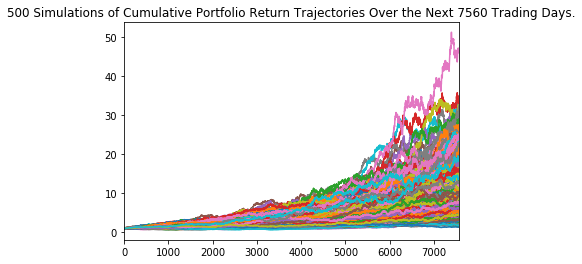

In [29]:
# Plot simulation outcomes
line_plot = MC_simulation.plot_simulation()

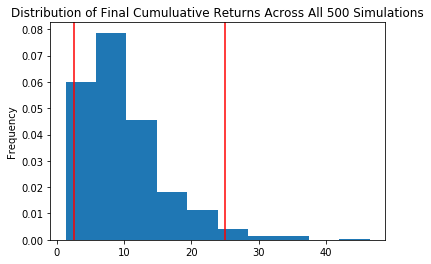

In [30]:
# Plot probability distribution and confidence intervals
dist_plot = MC_simulation.plot_distribution()

### Retirement Analysis

In [31]:
# Fetch summary statistics from the Monte Carlo simulation results
summary_stat = MC_simulation.summarize_cumulative_return()

# Print summary statistics
print(summary_stat)


count           500.000000
mean              9.919744
std               6.195742
min               1.284597
25%               5.401367
50%               8.617544
75%              12.488161
max              46.512875
95% CI Lower      2.585616
95% CI Upper     25.049543
Name: 7560, dtype: float64


### Calculate the expected portfolio return at the 95% lower and upper confidence intervals based on a `$20,000` initial investment.

In [32]:
# Set initial investment
initial_investment = 20000

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $20,000
summary_stat_ci_lower = round(summary_stat[8]*initial_investment,2)
summary_stat_ci_upper = round(summary_stat[9]*initial_investment,2)

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 30 years will end within in the range of"
      f" ${summary_stat_ci_lower} and ${summary_stat_ci_upper}")

There is a 95% chance that an initial investment of $20000 in the portfolio over the next 30 years will end within in the range of $51712.31 and $500990.86


### Calculate the expected portfolio return at the `95%` lower and upper confidence intervals based on a `50%` increase in the initial investment.

In [33]:
# Set initial investment
initial_investment = 20000 * 1.5

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $30,000
summary_stat_ci_lower = round(summary_stat[8]*initial_investment,2)
summary_stat_ci_upper = round(summary_stat[9]*initial_investment,2)

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 30 years will end within in the range of"
      f" ${summary_stat_ci_lower} and ${summary_stat_ci_upper}")

There is a 95% chance that an initial investment of $30000.0 in the portfolio over the next 30 years will end within in the range of $77568.47 and $751486.29
